In [ ]:
#IMPORTING NECESSARY LIBRARIES
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from seaborn import boxplot





## **HELPFUL FUNCTIONS**

Notebook Color Scheme:


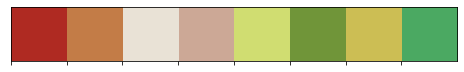

In [ ]:
# Custom colors
class clr:
    S = '\033[1m' + '\033[90m'
    E = '\033[0m'
my_colors = ["#af2a22", "#c37c47", "#e9e2d6", "#cca896", "#d0dd71", "#709539", "#ccbe54", "#4ba962"]

print(clr.S+"Notebook Color Scheme:"+clr.E)
sns.palplot(sns.color_palette(my_colors))
plt.show()

#======Show Values on Barplot========
import numpy as np
def show_values_on_bars(axs, h_v="v", space=.01):
    def _single(ax):
        if h_v == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height() + (p.get_height()*0.01)
                value = '{:.1f}'.format(p.get_height())
                ax.text(_x, _y, value, ha="center") 
        elif h_v == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height() - (p.get_height()*0.5)
                value = '{:.1f}'.format(p.get_width())
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _single(ax)
    else:
        _single(axs)

# **TRANSACTION DATA**

## **THE DATA**

In [ ]:
#importing the data from Local Harddisk
from google.colab import files
files.upload()

Saving QVI_transaction_data.csv to QVI_transaction_data.csv


{'QVI_transaction_data.csv': b'DATE;STORE_NBR;LYLTY_CARD_NBR;TXN_ID;PROD_NBR;PROD_NAME;PROD_QTY;TOT_SALES\r\n43390;1;1000;1;5;Natural Chip        Compny SeaSalt175g;2;6\r\n43599;1;1307;348;66;CCs Nacho Cheese    175g;3;6,3\r\n43605;1;1343;383;61;Smiths Crinkle Cut  Chips Chicken 170g;2;2,9\r\n43329;2;2373;974;69;Smiths Chip Thinly  S/Cream&Onion 175g;5;15\r\n43330;2;2426;1038;108;Kettle Tortilla ChpsHny&Jlpno Chili 150g;3;13,8\r\n43604;4;4074;2982;57;Old El Paso Salsa   Dip Tomato Mild 300g;1;5,1\r\n43601;4;4149;3333;16;Smiths Crinkle Chips Salt & Vinegar 330g;1;5,7\r\n43601;4;4196;3539;24;Grain Waves         Sweet Chilli 210g;1;3,6\r\n43332;5;5026;4525;42;Doritos Corn Chip Mexican Jalapeno 150g;1;3,9\r\n43330;7;7150;6900;52;Grain Waves Sour    Cream&Chives 210G;2;7,2\r\n43602;7;7215;7176;16;Smiths Crinkle Chips Salt & Vinegar 330g;1;5,7\r\n43332;8;8294;8221;114;Kettle Sensations   Siracha Lime 150g;5;23\r\n43603;9;9208;8634;15;Twisties Cheese     270g;2;9,2\r\n43329;13;13213;12447;92;

In [ ]:
##Reading the data
trans=pd.read_csv("QVI_transaction_data.csv", sep=';', decimal=',')

##Size of the Traindata
print(clr.S+"The size of the Transaction data is:"+clr.E, trans.shape)
print()
##showing a glimpse of Traindata
trans.head()

The size of the Transaction data is: (264836, 8)



,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES
0,43390,1,1000,1,5,Natural Chip Compny SeaSalt175g,2,6.0
1,43599,1,1307,348,66,CCs Nacho Cheese 175g,3,6.3
2,43605,1,1343,383,61,Smiths Crinkle Cut Chips Chicken 170g,2,2.9
3,43329,2,2373,974,69,Smiths Chip Thinly S/Cream&Onion 175g,5,15.0
4,43330,2,2426,1038,108,Kettle Tortilla ChpsHny&Jlpno Chili 150g,3,13.8


In [ ]:
#Transaction data General Info
trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264836 entries, 0 to 264835
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DATE            264836 non-null  int64  
 1   STORE_NBR       264836 non-null  int64  
 2   LYLTY_CARD_NBR  264836 non-null  int64  
 3   TXN_ID          264836 non-null  int64  
 4   PROD_NBR        264836 non-null  int64  
 5   PROD_NAME       264836 non-null  object 
 6   PROD_QTY        264836 non-null  int64  
 7   TOT_SALES       264836 non-null  float64
dtypes: float64(1), int64(6), object(1)
memory usage: 16.2+ MB


In [ ]:
#Transforming column DATE from type int64 to type datetime
trans['DATE']=pd.to_datetime(trans.DATE, origin='1900', unit='d')

In [ ]:
#Transforming columns STORE_NBR, LYLTY_CARD_NBR, TXN_ID, PROD_NBR from type int64 to type object
#due to those numbers are identification codes NOT real numbers
trans['STORE_NBR']=trans['STORE_NBR'].astype(object)
trans['LYLTY_CARD_NBR']=trans['LYLTY_CARD_NBR'].astype(object)
trans['TXN_ID']=trans['TXN_ID'].astype(object)
trans['PROD_NBR']=trans['PROD_NBR'].astype(object)

In [ ]:
#Transaction data General Info after transforming necessary columns
trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 264836 entries, 0 to 264835
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DATE            264836 non-null  datetime64[ns]
 1   STORE_NBR       264836 non-null  object        
 2   LYLTY_CARD_NBR  264836 non-null  object        
 3   TXN_ID          264836 non-null  object        
 4   PROD_NBR        264836 non-null  object        
 5   PROD_NAME       264836 non-null  object        
 6   PROD_QTY        264836 non-null  int64         
 7   TOT_SALES       264836 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1), object(5)
memory usage: 16.2+ MB


In [ ]:
#A Glimpse of Transaction data after transforming data types
trans

,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES
0,2018-10-19,1,1000,1,5,Natural Chip Compny SeaSalt175g,2,6.0
1,2019-05-16,1,1307,348,66,CCs Nacho Cheese 175g,3,6.3
2,2019-05-22,1,1343,383,61,Smiths Crinkle Cut Chips Chicken 170g,2,2.9
3,2018-08-19,2,2373,974,69,Smiths Chip Thinly S/Cream&Onion 175g,5,15.0
4,2018-08-20,2,2426,1038,108,Kettle Tortilla ChpsHny&Jlpno Chili 150g,3,13.8
...,...,...,...,...,...,...,...,...
264831,2019-03-11,272,272319,270088,89,Kettle Sweet Chilli And Sour Cream 175g,2,10.8
264832,2018-08-15,272,272358,270154,74,Tostitos Splash Of Lime 175g,1,4.4
264833,2018-11-08,272,272379,270187,51,Doritos Mexicana 170g,2,8.8
264834,2018-12-29,272,272379,270188,42,Doritos Corn Chip Mexican Jalapeno 150g,2,7.8


### **MISSING VALUES**

In [ ]:
#Count of MISSING VALUES (NULL VALUES) on TRANSACTION DATA
trans.isnull().sum()

DATE              0
STORE_NBR         0
LYLTY_CARD_NBR    0
TXN_ID            0
PROD_NBR          0
PROD_NAME         0
PROD_QTY          0
TOT_SALES         0
dtype: int64

#### **There is no Missing Values(Nan) in the dataset**

### **DROPPING OUT DUPLICATE ROWS**

In [ ]:
print(clr.S+'the rows count of the Transaction Data before treat duplicates is:'+clr.E, trans.shape[0], 'rows')
trans.drop_duplicates(subset=None, keep='first', inplace=True, ignore_index=False)
print(clr.S+'the rows count after eliminate duplicates shows:'+clr.E, trans.shape[0], 'rows')

the rows count of the Transaction Data before treat duplicates is: 264836 rows
the rows count after eliminate duplicates shows: 264835 rows


#### **That last result show us that there was just 1 duplicated row in the Transaction Data**

### **MAIN STATS OF THE DATA**

In [ ]:
#Some statistics of Transaction Data
trans.describe()

,PROD_QTY,TOT_SALES
count,264835.000000,264835.000000
mean,1.907308,7.304205
std,0.643655,3.083231
min,1.000000,1.500000
25%,2.000000,5.400000
50%,2.000000,7.400000
75%,2.000000,9.200000
max,200.000000,650.000000


### **OUTLIERS**

In [ ]:
trans.columns

Index(['DATE', 'STORE_NBR', 'LYLTY_CARD_NBR', 'TXN_ID', 'PROD_NBR',
       'PROD_NAME', 'PROD_QTY', 'TOT_SALES'],
      dtype='object')

Text(0.5, 1.0, 'VISUAL OF OUTLIERS IN TRANSACTION DATA')

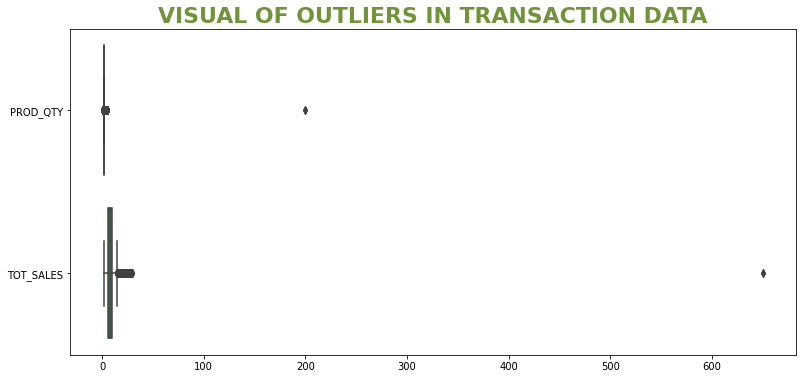

In [ ]:
#===setting up the boxplot to visualize Outliers in the entire data===
f, ax = plt.subplots(figsize=(13, 6))
boxplot(data=trans[['PROD_QTY', 'TOT_SALES']], orient='h', palette='Greens')
plt.title("VISUAL OF OUTLIERS IN TRANSACTION DATA", size=22, weight="bold", color=my_colors[5])

In [ ]:
#=======IDENTIFYING OUTLIERS IN TRANSACTION DATA======
#outliers column 'PROD_QTY'

q1p=trans['PROD_QTY'].quantile(0.25)
q3p=trans['PROD_QTY'].quantile(0.75)
iqrp=q3p-q1p
xp=1.5*iqrp
limaxp=(q3p+xp)
liminp=(q1p-xp)
outpq= (trans['PROD_QTY'] < liminp) | (trans['PROD_QTY'] > limaxp)
atipicop=trans[outpq]
print(atipicop[['PROD_QTY']].count())

#outliers column 'TOT_SALES'

q1ts=trans['TOT_SALES'].quantile(0.25)
q3ts=trans['TOT_SALES'].quantile(0.75)
iqrts=q3ts-q1ts
xts=1.5*iqrts
limaxts=(q3ts+xts)
limints=(q1ts-xts)
outts= (trans['TOT_SALES'] < limints) | (trans['TOT_SALES'] > limaxts)
atipicots=trans[outts]
print(atipicots[['TOT_SALES']].count())

PROD_QTY    28797
dtype: int64
TOT_SALES    578
dtype: int64


In [ ]:
#Showing Outliers as % of total
out3=(atipicop[['PROD_QTY']].count()/len(trans['PROD_QTY']))*100
print(clr.S+'Percent of Outliers'+clr.E, out3)
out4=(atipicots[['TOT_SALES']].count()/len(trans['TOT_SALES']))*100
print(clr.S+'Percent of Outliers'+clr.E, out4)

Percent of Outliers PROD_QTY    10.873563
dtype: float64
Percent of Outliers TOT_SALES    0.218249
dtype: float64


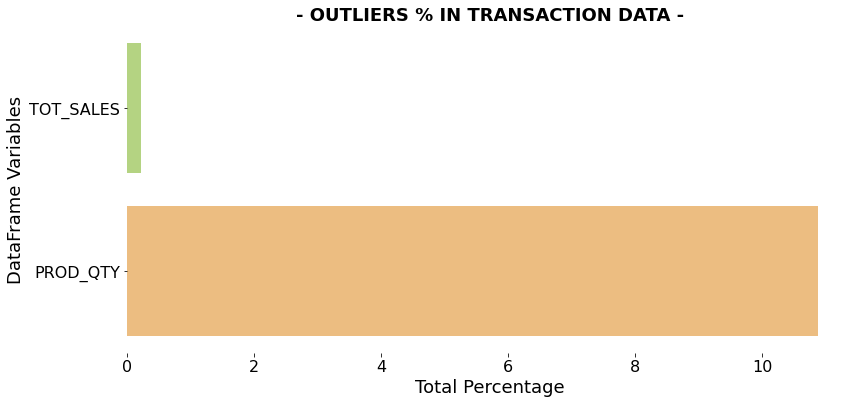

In [ ]:
# Showing a plot of OUTLIERS
from matplotlib import patches
plt.figure(figsize=(13,6))

out={'PROD_QTY':[10.873563],'TOT_SALES':[0.218249]}
outliers=pd.DataFrame(data=out)
outs=outliers.sort_values(by= [0], axis=1, ascending=True)
sns.barplot(data=outs, orient='h', palette='RdYlGn_r')
plt.title("- OUTLIERS % IN TRANSACTION DATA -", size=18, weight="bold")
plt.xlabel("Total Percentage", size=18)
plt.ylabel("DataFrame Variables", size=18)
plt.xticks(size=16)
plt.yticks(size=16)
sns.despine(left=True, bottom=True)
plt.show();

In [ ]:
#IDENTIFYING BOUNDARIES OF COLUMNS
#showing outliers boundaries in column 'PROD_QTY'
q1p=trans['PROD_QTY'].quantile(0.25)
q3p=trans['PROD_QTY'].quantile(0.75)
iqrp=q3p-q1p
xp=1.5*iqrp
limaxp=(q3p+xp)
liminp=(q1p-xp)
if liminp<=0:
  liminp=0
print(clr.S+'PROD_QTYs below', liminp, 'or above', limaxp, 'are considered Outliers'+clr.E)
print()

#showing outliers boundaries in column 'TOT_SALES'
q1ts=trans['TOT_SALES'].quantile(0.25)
q3ts=trans['TOT_SALES'].quantile(0.75)
iqrts=q3ts-q1ts
xts=1.5*iqrts
limaxts=(q3ts+xts)
limints=(q1ts-xts)
if limints<=0:
  limints=0
print(clr.S+'TOT_SALES below', limints, 'or above', limaxts, 'are considered Outliers'+clr.E)
print()

PROD_QTYs below 2.0 or above 2.0 are considered Outliers

TOT_SALES below 0 or above 14.899999999999999 are considered Outliers



###**Elimination of Outliers with presence of 2% or less**

In [ ]:
print('this the number of rows before eliminate Outliers of TOT_SALES : ', len(trans.index))

this the number of rows before eliminate Outliers of TOT_SALES :  264835


In [ ]:
trans=trans[trans.TOT_SALES<=14.90]
print('this the number of rows after eliminate Outliers of TOT_SALES: ', len(trans.index))

this the number of rows after eliminate Outliers of TOT_SALES:  264257


###**SUBSTITUTION OF OUTLIERS with presence of more than 2%**

In [ ]:
trans.loc[trans.PROD_QTY >2.0,'PROD_QTY']=trans['PROD_QTY'].median()

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

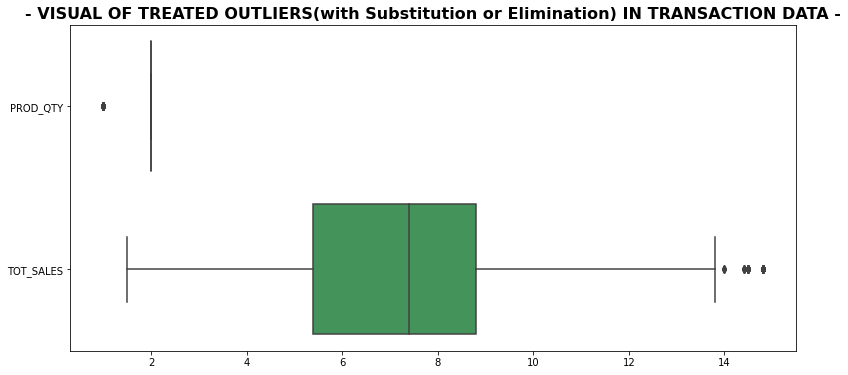

In [ ]:
f, ax = plt.subplots(figsize=(13, 6))
boxplot(data=trans[['PROD_QTY', 'TOT_SALES']], orient='h', palette='Greens')
plt.title("- VISUAL OF TREATED OUTLIERS(with Substitution or Elimination) IN TRANSACTION DATA -", size=16, weight="bold")
plt.savefig("TREATED OUTLIERS.png", dpi=150)
files.download("TREATED OUTLIERS.png")

### **CORRELATIONS**

In [ ]:
trans.corr()

,PROD_QTY,TOT_SALES
PROD_QTY,1.000000,0.493775
TOT_SALES,0.493775,1.000000


Text(0.5, 1.0, 'HEATMAP TRANSACTION DATA')

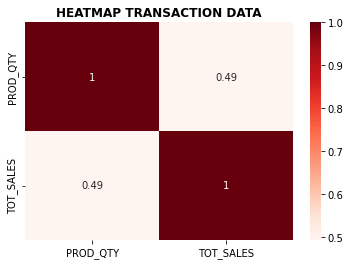

In [ ]:
sns.heatmap(trans.corr(), annot=True, cmap="Reds")
plt.title("HEATMAP TRANSACTION DATA", size=12, weight="bold")

In [ ]:
#SAVING THE NEW TRANSACTION DATA
trans.to_csv("transactions.csv")
files.download("transactions.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **CUSTOMER BEHAVIOUR DATA**

## **THE DATA**

In [ ]:
#importing the data from Local Harddisk
from google.colab import files
files.upload()

Saving QVI_purchase_behaviour.csv to QVI_purchase_behaviour.csv


{'QVI_purchase_behaviour.csv': b'LYLTY_CARD_NBR,LIFESTAGE,PREMIUM_CUSTOMER\r\n1000,YOUNG SINGLES/COUPLES,Premium\r\n1002,YOUNG SINGLES/COUPLES,Mainstream\r\n1003,YOUNG FAMILIES,Budget\r\n1004,OLDER SINGLES/COUPLES,Mainstream\r\n1005,MIDAGE SINGLES/COUPLES,Mainstream\r\n1007,YOUNG SINGLES/COUPLES,Budget\r\n1009,NEW FAMILIES,Premium\r\n1010,YOUNG SINGLES/COUPLES,Mainstream\r\n1011,OLDER SINGLES/COUPLES,Mainstream\r\n1012,OLDER FAMILIES,Mainstream\r\n1013,RETIREES,Budget\r\n1016,OLDER FAMILIES,Mainstream\r\n1018,YOUNG SINGLES/COUPLES,Mainstream\r\n1019,OLDER SINGLES/COUPLES,Premium\r\n1020,YOUNG SINGLES/COUPLES,Mainstream\r\n1022,OLDER FAMILIES,Budget\r\n1023,MIDAGE SINGLES/COUPLES,Premium\r\n1024,YOUNG SINGLES/COUPLES,Premium\r\n1025,YOUNG FAMILIES,Budget\r\n1026,MIDAGE SINGLES/COUPLES,Premium\r\n1027,OLDER FAMILIES,Premium\r\n1028,YOUNG SINGLES/COUPLES,Budget\r\n1030,RETIREES,Mainstream\r\n1034,RETIREES,Premium\r\n1038,OLDER FAMILIES,Mainstream\r\n1039,YOUNG FAMILIES,Mainstream\r\n1042,

In [ ]:
#Reading the data
custom=pd.read_csv("QVI_purchase_behaviour.csv", sep=',', decimal='.')
##Size of the Customer data
print(clr.S+"The size of the Customer data is:"+clr.E, custom.shape)
print()
##showing a glimpse of Customer Data
custom.head()

The size of the Customer data is: (72637, 3)



,LYLTY_CARD_NBR,LIFESTAGE,PREMIUM_CUSTOMER
0,1000,YOUNG SINGLES/COUPLES,Premium
1,1002,YOUNG SINGLES/COUPLES,Mainstream
2,1003,YOUNG FAMILIES,Budget
3,1004,OLDER SINGLES/COUPLES,Mainstream
4,1005,MIDAGE SINGLES/COUPLES,Mainstream


In [ ]:
#General Info of Customer data
custom.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72637 entries, 0 to 72636
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   LYLTY_CARD_NBR    72637 non-null  int64 
 1   LIFESTAGE         72637 non-null  object
 2   PREMIUM_CUSTOMER  72637 non-null  object
dtypes: int64(1), object(2)
memory usage: 1.7+ MB


In [ ]:
#Transforming columns LYLTY_CARD_NBR from type int64 to type object
#due to those numbers are identification codes NOT real numbers
custom['LYLTY_CARD_NBR']=custom['LYLTY_CARD_NBR'].astype(object)

In [ ]:
#verifying the transformations of datatype
custom.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72637 entries, 0 to 72636
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   LYLTY_CARD_NBR    72637 non-null  object
 1   LIFESTAGE         72637 non-null  object
 2   PREMIUM_CUSTOMER  72637 non-null  object
dtypes: object(3)
memory usage: 1.7+ MB


###**MISSING VALUES**
#### **the general info of Customer dataset show us that there is no MISSING VALUES on the dataset**

### **OUTLIERS**
#### **I won't check for Outliers due there is only categorical data**

### **DROPPING OUT DUPLICATE ROWS**


In [ ]:
print(clr.S+'the rows count of the Customer Data before treat duplicates is:'+clr.E, custom.shape[0], 'rows')
custom.drop_duplicates(subset=None, keep='first', inplace=True, ignore_index=False)
print(clr.S+'the rows count after eliminate duplicates shows:'+clr.E, custom.shape[0], 'rows')

the rows count of the Customer Data before treat duplicates is: 72637 rows
the rows count after eliminate duplicates shows: 72637 rows


#### **That last result show us that there is NO duplicated rows in the Customer Data**

In [ ]:
# UNIQUE VALUES OF VARIABLES IN CUSTOMER DATA
custom.nunique()

LYLTY_CARD_NBR      72637
LIFESTAGE               7
PREMIUM_CUSTOMER        3
dtype: int64

In [ ]:
#SAVING THE NEW CUSTOMER DATA
custom.to_csv("customer.csv")
files.download("customer.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# **MERGING THE TRANSACTION AND CUSTOMER DATA**

In [ ]:
#MERGING 
full=pd.merge(trans,custom, how='outer', indicator= True)
##Size of the Customer data
print(clr.S+"The size of the FULL data is:"+clr.E, full.shape)
print()
#A glimpse of full data
full.head()

The size of the FULL data is: (264306, 11)



,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES,LIFESTAGE,PREMIUM_CUSTOMER,_merge
0,2018-10-19,1,1000.0,1,5,Natural Chip Compny SeaSalt175g,2.0,6.0,YOUNG SINGLES/COUPLES,Premium,both
1,2019-05-16,1,1307.0,348,66,CCs Nacho Cheese 175g,2.0,6.3,MIDAGE SINGLES/COUPLES,Budget,both
2,2018-11-12,1,1307.0,346,96,WW Original Stacked Chips 160g,2.0,3.8,MIDAGE SINGLES/COUPLES,Budget,both
3,2019-03-11,1,1307.0,347,54,CCs Original 175g,1.0,2.1,MIDAGE SINGLES/COUPLES,Budget,both
4,2019-05-22,1,1343.0,383,61,Smiths Crinkle Cut Chips Chicken 170g,2.0,2.9,MIDAGE SINGLES/COUPLES,Budget,both


In [ ]:
full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264306 entries, 0 to 264305
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   DATE              264257 non-null  datetime64[ns]
 1   STORE_NBR         264257 non-null  object        
 2   LYLTY_CARD_NBR    264306 non-null  object        
 3   TXN_ID            264257 non-null  object        
 4   PROD_NBR          264257 non-null  object        
 5   PROD_NAME         264257 non-null  object        
 6   PROD_QTY          264257 non-null  float64       
 7   TOT_SALES         264257 non-null  float64       
 8   LIFESTAGE         264306 non-null  object        
 9   PREMIUM_CUSTOMER  264306 non-null  object        
 10  _merge            264306 non-null  category      
dtypes: category(1), datetime64[ns](1), float64(2), object(7)
memory usage: 22.4+ MB


## **TRANSACTION ANALYSIS**

In [ ]:
# UNIQUE VALUES of VARIABLES
full.nunique()

DATE                   364
STORE_NBR              272
LYLTY_CARD_NBR       72637
TXN_ID              262552
PROD_NBR               114
PROD_NAME              114
PROD_QTY                 2
TOT_SALES               81
LIFESTAGE                7
PREMIUM_CUSTOMER         3
_merge                   2
dtype: int64

In [ ]:
# Categorical columns in the training data
object_cols = [col for col in full.columns if full[col].dtype == "object"]
# Get number of unique entries in each column with categorical data
object_nunique = list(map(lambda col: full[col].nunique(), object_cols))
d = dict(zip(object_cols, object_nunique))

# Print number of unique entries by column, in ascending order
print(clr.S+"This is the count of unique values for categorical variables:"+clr.E)
sorted(d.items(), key=lambda x: x[1])

This is the count of unique values for categorical variables:


[('PREMIUM_CUSTOMER', 3),
 ('LIFESTAGE', 7),
 ('PROD_NBR', 114),
 ('PROD_NAME', 114),
 ('STORE_NBR', 272),
 ('LYLTY_CARD_NBR', 72637),
 ('TXN_ID', 262552)]

### **TOP PRODUCTS**

In [ ]:
#DataFrame with top sellers
suma=full.groupby('PROD_NAME').sum().groupby(level=[0]).cumsum()
top=suma.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top

,PROD_QTY,TOT_SALES
PROD_NAME,,
Dorito Corn Chp Supreme 380g,6060.0,38918.75
Smiths Crnkle Chip Orgnl Big Bag 380g,6086.0,35907.40
Smiths Crinkle Chips Salt & Vinegar 330g,6065.0,34570.50
Smiths Crinkle Original 330g,5972.0,34040.40
Kettle Mozzarella Basil & Pesto 175g,6284.0,33933.60
Cheezels Cheese 330g,5940.0,33858.00
Doritos Cheese Supreme 330g,5792.0,33014.40
Kettle Sweet Chilli And Sour Cream 175g,6075.0,32805.00
Kettle Sea Salt And Vinegar 175g,6006.0,32432.40


**It seems like there is a mistake in name Dorito instead of Doritos Brand name, and other case in name Smiths Crnkle instead of Smiths Crinkle so  I will change names in the columns**

In [ ]:
full['PROD_NAME']=full['PROD_NAME'].str.replace("Dorito", "Doritos")
full['PROD_NAME']=full['PROD_NAME'].str.replace("Crnkle", "Crinkle")

In [ ]:
full['PROD_NAME'].head(20)

0       Natural Chip        Compny SeaSalt175g
1                     CCs Nacho Cheese    175g
2               WW Original Stacked Chips 160g
3                            CCs Original 175g
4       Smiths Crinkle Cut  Chips Chicken 170g
5     Kettle Tortilla ChpsHny&Jlpno Chili 150g
6     Old El Paso Salsa   Dip Tomato Mild 300g
7      Tyrrells Crisps     Lightly Salted 165g
8         Kettle Tortilla ChpsFeta&Garlic 150g
9            Doritos Corn Chp     Supreme 380g
10                   Doritoss Mexicana    170g
11    Smiths Crinkle Chips Salt & Vinegar 330g
12                        Kettle Original 175g
13      Tyrrells Crisps     Ched & Chives 165g
14     Infuzions BBQ Rib   Prawn Crackers 110g
15       Grain Waves         Sweet Chilli 210g
16     Old El Paso Salsa   Dip Tomato Med 300g
17    Doritoss Corn Chip Southern Chicken 150g
18        Kettle Tortilla ChpsFeta&Garlic 150g
19        Thins Potato Chips  Hot & Spicy 175g
Name: PROD_NAME, dtype: object

#### **Now We see Dorito fixed but Doritos as Doritoss so here we go again and fix that new error**

In [ ]:
full['PROD_NAME']=full['PROD_NAME'].str.replace("Doritoss", "Doritos")

In [ ]:
full['PROD_NAME'].head(20)

0       Natural Chip        Compny SeaSalt175g
1                     CCs Nacho Cheese    175g
2               WW Original Stacked Chips 160g
3                            CCs Original 175g
4       Smiths Crinkle Cut  Chips Chicken 170g
5     Kettle Tortilla ChpsHny&Jlpno Chili 150g
6     Old El Paso Salsa   Dip Tomato Mild 300g
7      Tyrrells Crisps     Lightly Salted 165g
8         Kettle Tortilla ChpsFeta&Garlic 150g
9            Doritos Corn Chp     Supreme 380g
10                    Doritos Mexicana    170g
11    Smiths Crinkle Chips Salt & Vinegar 330g
12                        Kettle Original 175g
13      Tyrrells Crisps     Ched & Chives 165g
14     Infuzions BBQ Rib   Prawn Crackers 110g
15       Grain Waves         Sweet Chilli 210g
16     Old El Paso Salsa   Dip Tomato Med 300g
17     Doritos Corn Chip Southern Chicken 150g
18        Kettle Tortilla ChpsFeta&Garlic 150g
19        Thins Potato Chips  Hot & Spicy 175g
Name: PROD_NAME, dtype: object

#### **Situation with Doritos SOLVED as we can see in the above glimpse of Data**

In [ ]:
#SAVING THE NEW CUSTOMER DATA
full.to_csv("mergedData.csv")
files.download("mergedData.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### **Let's continue...**

In [ ]:
#DataFrame with top sellers by Quantity 
suma2=full.groupby('PROD_NAME').sum().groupby(level=[0]).cumsum()
top7=suma2.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top7

,PROD_QTY,TOT_SALES
PROD_NAME,,
Kettle Mozzarella Basil & Pesto 175g,6284.0,33933.6
Kettle Tortilla ChpsHny&Jlpno Chili 150g,6252.0,28786.8
Cobs Popd Sea Salt Chips 110g,6243.0,23742.4
Cobs Popd Swt/Chlli &Sr/Cream Chips 110g,6213.0,23620.8
Tyrrells Crisps Ched & Chives 165g,6200.0,26077.8
Tostitos Splash Of Lime 175g,6188.0,27262.4
Kettle 135g Swt Pot Sea Salt,6179.0,25972.8
Infuzions Thai SweetChili PotatoMix 110g,6174.0,23476.4
Thins Potato Chips Hot & Spicy 175g,6149.0,20328.0


#### **After analyze the two charts it can be said that the sizes best selled in terms of Quantity were those between 110g and 175g but in terms of Revenues the sizes bigger than 300g were the big winners**

#### **It is remarkable that 175g pack size figures (at least 30%) in both lists(Best Selling Chips by quantity and by revenues)**

In [ ]:
#EXPORTING CHART TO EXCEL
top.to_excel('BestProducts.xlsx')
files.download("BestProducts.xlsx")
top7.to_excel('BestProductsQty.xlsx')
files.download("BestProductsQty.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### **Let's take a look at pack sizes**

In [ ]:
full[['PROD_QTY', 'TOT_SALES']].sum()

PROD_QTY      500996.00
TOT_SALES    1921750.95
dtype: float64

In [ ]:
hsf=full.groupby(full.PROD_NAME.str.contains('175g')).sum().groupby(level=[0]).cumsum()
top8=hsf.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top8['ProdQty_Pct']=(top8['PROD_QTY']/(top8['PROD_QTY'].sum()))*100
top8['TotSal_Pct']=(top8['TOT_SALES']/(top8['TOT_SALES'].sum()))*100
top8

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,378266.0,1447951.55,75.502798,75.345432
True,122730.0,473799.40,24.497202,24.654568


#### **175g pack size represents almost 25% of Sales!!!**

In [ ]:
#DataFrame with top sellers by Selected Quantity 
hf=full.groupby(full.PROD_NAME.str.contains('150g')).sum().groupby(level=[0]).cumsum()
top9=hf.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top9['ProdQty_Pct']=(top9['PROD_QTY']/(top9['PROD_QTY'].sum()))*100
top9['TotSal_Pct']=(top9['TOT_SALES']/(top9['TOT_SALES'].sum()))*100
top9

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,422195.0,1626507.35,84.271132,84.63674
True,78801.0,295243.60,15.728868,15.36326


175g 24,6%
150g 15,5%

SUM=40,1%

#### **plus 150g pack size sums 40% of Sales** 

In [ ]:
#DataFrame with top sellers by Quantity 
htf=full.groupby(full.PROD_NAME.str.contains('134g')).sum().groupby(level=[0]).cumsum()
top10=htf.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top10['ProdQty_Pct']=(top10['PROD_QTY']/(top10['PROD_QTY'].sum()))*100
top10['TotSal_Pct']=(top10['TOT_SALES']/(top10['TOT_SALES'].sum()))*100
top10

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,453350.0,1745020.45,90.489744,90.803673
True,47646.0,176730.50,9.510256,9.196327


175g+150g=40,1%
134 9,4%
SUM=49,5%

#### **AND plus 134g pack size all 3 together sums 50% of Sales!!!**

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

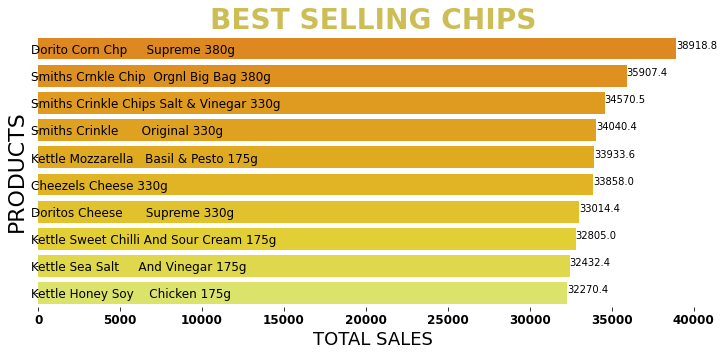

In [ ]:
#==========PLOT OF TOP SELLERS=============
fig,ax=plt.subplots(figsize=(12,5))
sns.barplot(data=top, y=top.index, x=top['TOT_SALES'], orient='h', palette='Wistia_r')
plt.title("BEST SELLING CHIPS", size=28, weight="bold", color=my_colors[6])
show_values_on_bars(ax, h_v="h", space=.09)
plt.xlabel("TOTAL SALES", size=18)
plt.ylabel("PRODUCTS", size=22)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='left')
sns.despine(left=True, bottom=True)
plt.savefig("BEST SELLERS CHIPS.png", dpi=150)
files.download("BEST SELLERS CHIPS.png")

### **How about Brand names?**

In [ ]:
bn=full.groupby(full.PROD_NAME.str.contains('Doritos')).sum().groupby(level=[0]).cumsum()
top11=bn.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top11['ProdQty_Pct']=(top11['PROD_QTY']/(top11['PROD_QTY'].sum()))*100
top11['TotSal_Pct']=(top11['TOT_SALES']/(top11['TOT_SALES'].sum()))*100
top11

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,447588.0,1682598.00,89.339635,87.555466
True,53408.0,239152.95,10.660365,12.444534


In [ ]:
bn2=full.groupby(full.PROD_NAME.str.contains('Smith')).sum().groupby(level=[0]).cumsum()
top12=bn2.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top12['ProdQty_Pct']=(top12['PROD_QTY']/(top12['PROD_QTY'].sum()))*100
top12['TotSal_Pct']=(top12['TOT_SALES']/(top12['TOT_SALES'].sum()))*100
top12

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,441056.0,1698172.85,88.035833,88.365917
True,59940.0,223578.10,11.964167,11.634083


In [ ]:
bn3=full.groupby(full.PROD_NAME.str.contains('Kettle')).sum().groupby(level=[0]).cumsum()
top13=bn3.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top13['ProdQty_Pct']=(top13['PROD_QTY']/(top13['PROD_QTY'].sum()))*100
top13['TotSal_Pct']=(top13['TOT_SALES']/(top13['TOT_SALES'].sum()))*100
top13

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,422617.0,1534684.75,84.355364,79.85867
True,78379.0,387066.20,15.644636,20.14133


In [ ]:
bn4=full.groupby(full.PROD_NAME.str.contains('Pringles')).sum().groupby(level=[0]).cumsum()
top14=bn4.sort_values(by=['PROD_QTY'], axis=0, ascending=False).head(10)
top14['ProdQty_Pct']=(top14['PROD_QTY']/(top14['PROD_QTY'].sum()))*100
top14['TotSal_Pct']=(top14['TOT_SALES']/(top14['TOT_SALES'].sum()))*100
top14

,PROD_QTY,TOT_SALES,ProdQty_Pct,TotSal_Pct
PROD_NAME,,,,
False,453350.0,1745020.45,90.489744,90.803673
True,47646.0,176730.50,9.510256,9.196327


kettle 17,89
smiths 11,80
doritos 11,55
pringles 9,36

SUM= 50,6%
#### **Kettle Brand name represents near 20% of Sales!!!**

#### **Along with Smiths, Doritos and Pringles Brand names sums 50% of Sales!!!**


### **TOP STORES**

In [ ]:
#DataFrame with top selling Stores
sto=full.groupby('STORE_NBR').sum().groupby(level=[0]).cumsum()
top2=sto.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top2

,PROD_QTY,TOT_SALES
STORE_NBR,,
226,3959.0,17454.45
88,3691.0,16222.95
165,3555.0,15801.75
40,3479.0,15484.60
237,3503.0,15477.70
58,3440.0,15173.05
199,3325.0,14747.20
4,3309.0,14629.95
203,3265.0,14475.10


In [ ]:
#EXPORTING CHART TO EXCEL
top2.to_excel('BestStores.xlsx')
files.download("BestStores.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

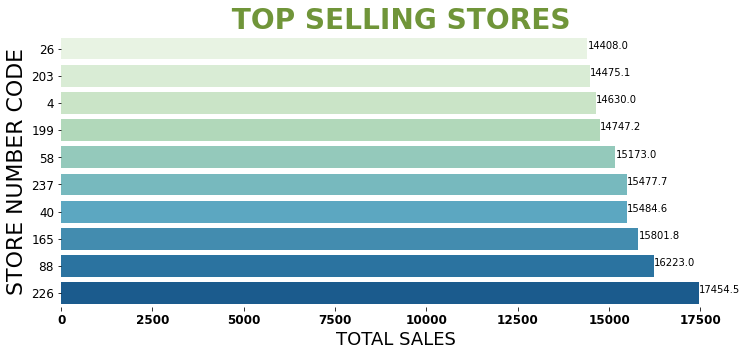

In [ ]:
#==========PLOT OF TOP SELLERS STORES=============
fig,ax=plt.subplots(figsize=(12,5))
sns.barplot(data=top2, y=top2.index, x=(top2['TOT_SALES']), order=top2.sort_values('TOT_SALES').index, orient='h', palette='GnBu')
plt.title(" TOP SELLING STORES", size=28, weight="bold", color=my_colors[5])
show_values_on_bars(ax, h_v="h", space=.09),round(2)
plt.xlabel("TOTAL SALES", size=18)
plt.ylabel("STORE NUMBER CODE", size=22)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='right')
sns.despine(left=True, bottom=True)
plt.savefig("TOP STORES.png", dpi=150)
files.download("TOP STORES.png")

In [ ]:
pd.set_option('display.max_rows', None)
tsf=full.groupby([full.PROD_NAME.str.contains('175g'),full['STORE_NBR']]).sum()
top20=tsf.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
from IPython.display import HTML, display_html, display
display(HTML('<h2>Top selling stores of the 175g pack</h2>'))
display_html(top20)
#EXPORTING CHART TO EXCEL
top20.to_excel('Best175gStores.xlsx')
files.download("Best175gStores.xlsx")

PROD_QTY 
 TOT_SALES 
 
 
 PROD_NAME 
 STORE_NBR 
 
 
 
 
 
 
 True 
 226 
 887.0 
 3962.5 
 
 
 88 
 848.0 
 3845.3 
 
 
 237 
 821.0 
 3718.3 
 
 
 40 
 803.0 
 3651.3 
 
 
 203 
 795.0 
 3620.3 
 
 
 58 
 794.0 
 3590.7 
 
 
 165 
 792.0 
 3569.5 
 
 
 199 
 775.0 
 3550.7 
 
 
 26 
 772.0 
 3512.2 
 
 
 230 
 948.0 
 3445.6

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
tsf2=full.groupby([full.PROD_NAME.str.contains('Kettle'),full['STORE_NBR']]).sum()
top21=tsf2.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
from IPython.display import HTML, display_html, display
display(HTML('<h2>Top selling stores of Kettle Brand name</h2>'))
display_html(top21)
#EXPORTING CHART TO EXCEL
top21.to_excel('BestKettleStores.xlsx')
files.download("BestKettleStores.xlsx")

PROD_QTY 
 TOT_SALES 
 
 
 PROD_NAME 
 STORE_NBR 
 
 
 
 
 
 
 True 
 226 
 870.0 
 4277.6 
 
 
 88 
 845.0 
 4172.2 
 
 
 165 
 820.0 
 4039.2 
 
 
 40 
 790.0 
 3916.4 
 
 
 26 
 787.0 
 3891.4 
 
 
 58 
 785.0 
 3884.2 
 
 
 199 
 774.0 
 3847.2 
 
 
 237 
 766.0 
 3814.4 
 
 
 4 
 761.0 
 3758.8 
 
 
 181 
 735.0 
 3644.2

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### **Stores 226 and 88 are the best sellers of 175g pack size and Kettle Brand name, so it is reasonable that they appear as the the top 2 Best Selling Stores of Chips**

### **TOP CUSTOMERS**

In [ ]:
#DataFrame with top customers
cl=full.groupby('LYLTY_CARD_NBR').sum().groupby(level=[0]).cumsum()
top3=cl.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top3

,PROD_QTY,TOT_SALES
LYLTY_CARD_NBR,,
230078.0,34.0,138.60
259009.0,30.0,127.20
162039.0,36.0,126.80
58361.0,28.0,124.80
94185.0,32.0,122.80
130090.0,27.0,122.65
179228.0,32.0,120.80
172032.0,35.0,120.10
199157.0,26.0,118.80


In [ ]:
#EXPORTING CHART TO EXCEL
top3.to_excel('BestCustomers.xlsx')
files.download("BestCustomers.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

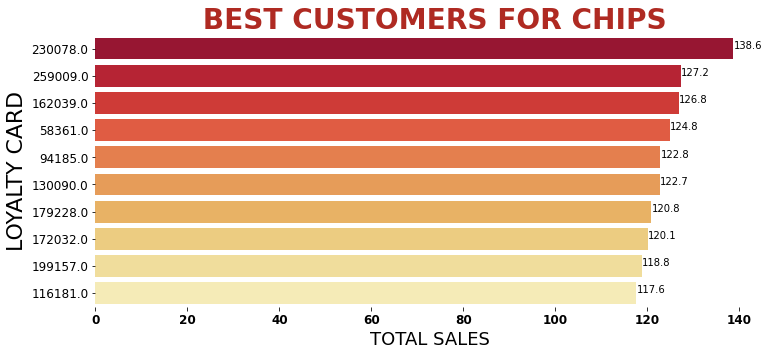

In [ ]:
#==========PLOT OF BEST CUSTOMERS=============
fig,ax=plt.subplots(figsize=(12,5))
sns.barplot(data=top3, y=top3.index, x=(top3['TOT_SALES']), order=top3.sort_values('TOT_SALES', ascending=False).index, orient='h', palette='YlOrRd_r')
plt.title(" BEST CUSTOMERS FOR CHIPS", size=28, weight="bold", color=my_colors[0])
show_values_on_bars(ax, h_v="h", space=.09),round(2)
plt.xlabel("TOTAL SALES", size=18)
plt.ylabel("LOYALTY CARD", size=22)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='right')
sns.despine(left=True, bottom=True)
plt.savefig("BEST CUSTOMERS.png", dpi=150)
files.download("BEST CUSTOMERS.png")

### **HOT DATES**

In [ ]:
#DataFrame with best selling dates
dat=full.groupby('DATE').sum().groupby(level=[0]).cumsum()
top4=dat.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top4

,PROD_QTY,TOT_SALES
DATE,,
2018-12-26,1818.0,6923.0
2018-12-25,1771.0,6826.0
2018-12-21,1734.0,6639.8
2018-12-24,1746.0,6558.7
2018-12-22,1649.0,6300.8
2018-12-20,1651.0,6209.6
2018-12-23,1616.0,6201.3
2019-06-09,1556.0,5924.1
2018-09-08,1514.0,5864.5


In [ ]:
#EXPORTING CHART TO EXCEL
top4.to_excel('hotDates.xlsx')
files.download("hotDates.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

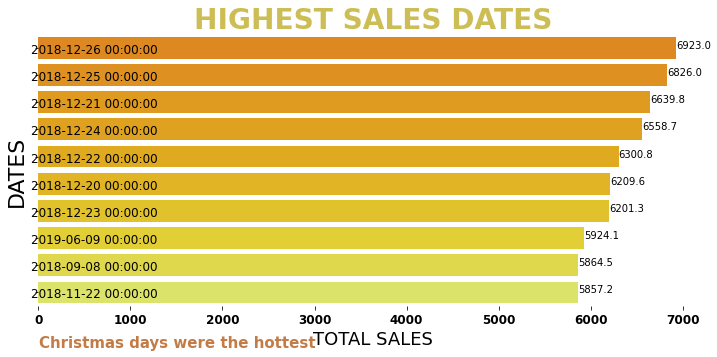

In [ ]:
#==========PLOT OF HIGHEST SALES DATES=============
fig,ax=plt.subplots(figsize=(12,5))
sns.barplot(data=top4, y=top4.index, x=top4['TOT_SALES'], order=top4.sort_values('TOT_SALES', ascending=False).index, orient='h', palette='Wistia_r')
plt.title("HIGHEST SALES DATES", size=28, weight="bold", color=my_colors[6])
show_values_on_bars(ax, h_v="h", space=.09),round(2)
plt.xlabel("TOTAL SALES", size=18)
plt.ylabel("DATES", size=22)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='left')
plt.text(x=10.5, y=11, s='Christmas days were the hottest', color=my_colors[1], size=15, weight='heavy')
sns.despine(left=True, bottom=True)
plt.savefig("HOT DATES.png", dpi=150)
files.download("HOT DATES.png")

In [ ]:
tsf3=full.groupby([full.PROD_NAME.str.contains('175g'),full['DATE']]).sum()
top22=tsf3.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>Hot Dates of 175g pack size sales</h2>'))
display_html(top22)
#EXPORTING CHART TO EXCEL
top22.to_excel('Best175gDates.xlsx')
files.download("Best175gDates.xlsx")

PROD_QTY 
 TOT_SALES 
 
 
 PROD_NAME 
 DATE 
 
 
 
 
 
 
 True 
 2018-12-24 
 456.0 
 1728.3 
 
 
 2018-12-20 
 456.0 
 1719.1 
 
 
 2018-12-25 
 447.0 
 1690.7 
 
 
 2018-12-26 
 423.0 
 1618.1 
 
 
 2018-12-22 
 419.0 
 1592.9 
 
 
 2019-02-04 
 415.0 
 1586.5 
 
 
 2018-12-30 
 409.0 
 1584.2 
 
 
 2018-09-08 
 407.0 
 1582.5 
 
 
 2019-04-07 
 399.0 
 1560.6 
 
 
 2018-09-06 
 402.0 
 1559.3

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
tsf4=full.groupby([full.PROD_NAME.str.contains('Kettle'),full['DATE']]).sum()
top23=tsf4.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>Hot Dates of Kettle Brand name sales</h2>'))
display_html(top23)
#EXPORTING CHART TO EXCEL
top23.to_excel('BestKettleDates.xlsx')
files.download("BestKettleDates.xlsx")

PROD_QTY 
 TOT_SALES 
 
 
 PROD_NAME 
 DATE 
 
 
 
 
 
 
 True 
 2018-11-22 
 296.0 
 1446.8 
 
 
 2018-09-25 
 280.0 
 1375.6 
 
 
 2018-11-06 
 271.0 
 1337.4 
 
 
 2018-09-06 
 269.0 
 1329.0 
 
 
 2019-06-23 
 269.0 
 1326.6 
 
 
 2018-12-26 
 267.0 
 1314.2 
 
 
 2018-09-27 
 266.0 
 1314.0 
 
 
 2019-03-14 
 263.0 
 1309.8 
 
 
 2019-06-15 
 261.0 
 1301.8 
 
 
 2018-11-08 
 259.0 
 1290.6

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## **CUSTOMER ANALYSIS**

In [ ]:
#DataFrame with Sales by Customer Type
pre=full.groupby('PREMIUM_CUSTOMER').sum().groupby(level=[0]).cumsum()
top5=pre.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top5['TOT_Pct']=(top5['TOT_SALES']/(top5['TOT_SALES'].sum()))*100
top5

,PROD_QTY,TOT_SALES,TOT_Pct
PREMIUM_CUSTOMER,,,
Mainstream,192585.0,746475.85,38.843527
Budget,176548.0,671985.80,34.967372
Premium,131863.0,503289.30,26.189101


In [ ]:
#EXPORTING CHART TO EXCEL
top5.to_excel('consumptionCustomerType.xlsx')
files.download("consumptionCustomerType.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

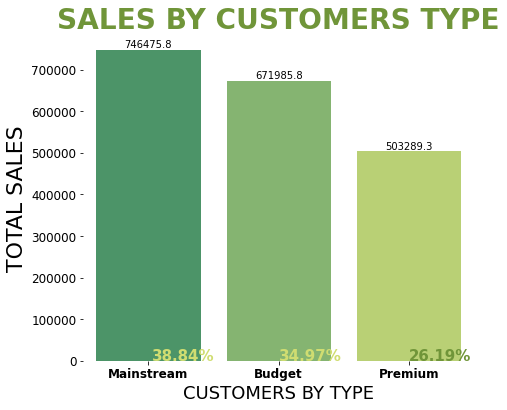

In [ ]:
#==========PLOT OF SALES BY CUSTOMER TYPE=============
fig,ax=plt.subplots(figsize=(7,6))
sns.barplot(data=top5, x=top5.index, y=(top5['TOT_SALES']), order=top5.sort_values('TOT_SALES', ascending=False).index, orient='v', palette='summer')
plt.title("SALES BY CUSTOMERS TYPE", size=28, weight="bold", color=my_colors[5])
show_values_on_bars(ax, h_v="v", space=.09),round(2)
plt.xlabel("CUSTOMERS BY TYPE", size=18)
plt.ylabel("TOTAL SALES", size=22)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='right')
plt.text(x=0.03, y=3, s='38.84%', color=my_colors[4], size=15, weight='heavy')
plt.text(x=1.0, y=2, s='34.97%', color=my_colors[4], size=15, weight='heavy')
plt.text(x=2.0, y=3, s='26.19%', color=my_colors[5], size=15, weight='heavy')
sns.despine(left=True, bottom=True)
plt.savefig("salesCustomTy.png", dpi=150)
files.download("salesCustomTy.png")


In [ ]:
#DataFrame with Customers by Type
pre2=full.groupby('PREMIUM_CUSTOMER').count()
pre2['CARDNBR_Pct']=(pre2['LYLTY_CARD_NBR']/(pre2['LYLTY_CARD_NBR'].sum()))*100
pre2

,DATE,STORE_NBR,LYLTY_CARD_NBR,TXN_ID,PROD_NBR,PROD_NAME,PROD_QTY,TOT_SALES,LIFESTAGE,_merge,CARDNBR_Pct
PREMIUM_CUSTOMER,,,,,,,,,,,
Budget,92943,92943,92963,92943,92943,92943,92943,92943,92963,92963,35.172489
Mainstream,101770,101770,101794,101770,101770,101770,101770,101770,101794,101794,38.513692
Premium,69544,69544,69549,69544,69544,69544,69544,69544,69549,69549,26.313818


In [ ]:
#EXPORTING CHART TO EXCEL
pre2.to_excel('CustomerType.xlsx')
files.download("CustomerType.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

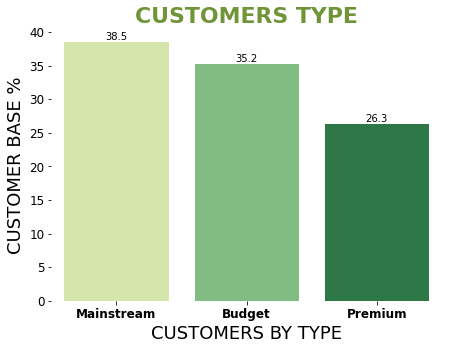

In [ ]:
#==========PLOT OF SALES BY CUSTOMER TYPE=============
fig,ax=plt.subplots(figsize=(7,5))
sns.barplot(data=pre2, x=pre2.index, y=(pre2['CARDNBR_Pct']), order=pre2.sort_values('CARDNBR_Pct', ascending=False).index, orient='v', palette='YlGn')
plt.title("CUSTOMERS TYPE", size=22, weight="bold", color=my_colors[5])
show_values_on_bars(ax, h_v="v", space=.09), round(4)
plt.xlabel("CUSTOMERS BY TYPE", size=18)
plt.ylabel("CUSTOMER BASE %", size=18)
plt.xticks(size=12, rotation=0, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='right')
sns.despine(left=True, bottom=True)
plt.savefig("CustomTy.png", dpi=150)
files.download("CustomTy.png")

In [ ]:
tsf5=full.groupby([full.PROD_NAME.str.contains('175g'),full['PREMIUM_CUSTOMER']]).sum()
top24=tsf5.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
top24['TOT_Pct']=(top24['TOT_SALES']/(top24['TOT_SALES'].sum()))*100
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>SALES of 175g pack size by Customer Type</h2>'))
display_html(top24)
#EXPORTING CHART TO EXCEL
top24.to_excel('175gByCustomerType.xlsx')
files.download("175gByCustomerType.xlsx")

PROD_QTY 
 TOT_SALES 
 TOT_Pct 
 
 
 PROD_NAME 
 PREMIUM_CUSTOMER 
 
 
 
 
 
 
 
 True 
 Mainstream 
 46422.0 
 180952.60 
 9.416028 
 
 
 Budget 
 43606.0 
 167025.40 
 8.691314 
 
 
 Premium 
 32702.0 
 125821.40 
 6.547227 
 
 
 False 
 Mainstream 
 146163.0 
 565523.25 
 29.427499 
 
 
 Budget 
 132942.0 
 504960.40 
 26.276058 
 
 
 Premium 
 99161.0 
 377467.90 
 19.641874

In [ ]:
tsf6=full.groupby([full.PROD_NAME.str.contains('Kettle'),full['PREMIUM_CUSTOMER']]).sum()
top25=tsf6.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
top25['TOT_pct']=(top25['TOT_SALES']/(top25['TOT_SALES'].sum()))*100
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>SALES of Kettle Brand name by Customer Type</h2>'))
display_html(top25)
#EXPORTING CHART TO EXCEL
top25.to_excel('KettleBrandByCustomerType.xlsx')
files.download("KettleBrandByCustomerType.xlsx")

PROD_QTY 
 TOT_SALES 
 TOT_pct 
 
 
 PROD_NAME 
 PREMIUM_CUSTOMER 
 
 
 
 
 
 
 
 True 
 Mainstream 
 31042.0 
 153087.40 
 7.966037 
 
 
 Budget 
 26973.0 
 133316.20 
 6.937226 
 
 
 Premium 
 20364.0 
 100662.60 
 5.238067 
 
 
 False 
 Mainstream 
 161543.0 
 593388.45 
 30.877490 
 
 
 Budget 
 149575.0 
 538669.60 
 28.030146 
 
 
 Premium 
 111499.0 
 402626.70 
 20.951034

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### **Mainstream and Budget Customers are the bigger consumers of 175g pack size and Kettle Brand name**

### **LIFE STAGE OF CUSTOMERS**

In [ ]:
#DataFrame with Sales by Life Stage
lif=full.groupby('LIFESTAGE').sum().groupby(level=[0]).cumsum()
top6=lif.sort_values(by=['TOT_SALES'], axis=0, ascending=False).head(10)
top6['TOT_Pct']=(top6['TOT_SALES']/(top6['TOT_SALES'].sum()))*100
top6

,PROD_QTY,TOT_SALES,TOT_Pct
LIFESTAGE,,,
OLDER SINGLES/COUPLES,103461.0,399965.15,20.812538
RETIREES,93544.0,364567.65,18.970598
OLDER FAMILIES,93752.0,349945.25,18.209709
YOUNG FAMILIES,83819.0,314096.85,16.344306
YOUNG SINGLES/COUPLES,66260.0,259340.00,13.494985
MIDAGE SINGLES/COUPLES,47365.0,183582.95,9.552900
NEW FAMILIES,12795.0,50253.10,2.614964


In [ ]:
#EXPORTING CHART TO EXCEL
top6.to_excel('salesLife.xlsx')
files.download("salesLife.xlsx")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

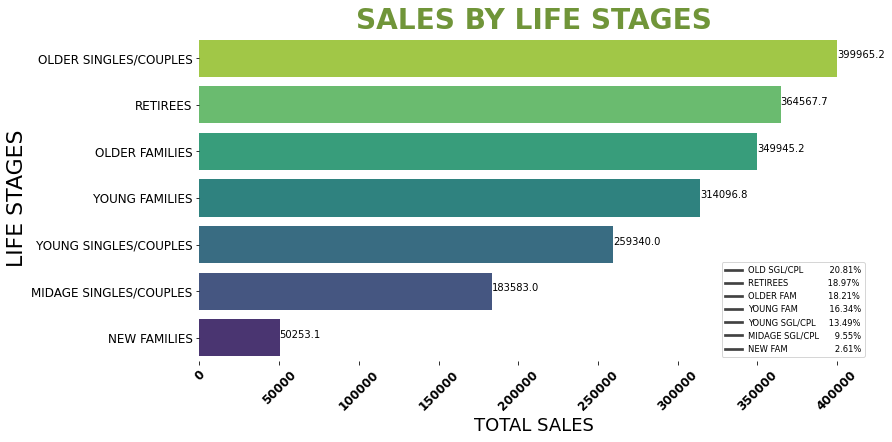

In [ ]:
#==========PLOT OF SALES BY LIFE STAGES=============
fig,ax=plt.subplots(figsize=(12,6))
sns.barplot(data=top6, y=top6.index, x=(top6['TOT_SALES']), 
            order=top6.sort_values('TOT_SALES', ascending=False).index,
            orient='h', palette='viridis_r')
plt.title("SALES BY LIFE STAGES", size=28, weight="bold", color=my_colors[5])
show_values_on_bars(ax, h_v="h", space=.09),round(2)
plt.xlabel("TOTAL SALES", size=18)
plt.ylabel("LIFE STAGES", size=22)
plt.xticks(size=12, rotation=45, weight='heavy')
plt.yticks(size=12, weight='normal', horizontalalignment='right')

plt.legend(['OLD SGL/CPL          20.81%', 
            'RETIREES               18.97%',
            'OLDER FAM            18.21%',
            'YOUNG FAM            16.34%',
            'YOUNG SGL/CPL     13.49%',
            'MIDAGE SGL/CPL      9.55%',
            'NEW FAM                  2.61%'], loc=4, fontsize='small')
sns.despine(left=True, bottom=True)
plt.savefig("salesLife.png", dpi=150)
files.download("salesLife.png")

In [ ]:
tsf7=full.groupby([full.PROD_NAME.str.contains('175g'),full['LIFESTAGE']]).sum()
top26=tsf7.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
top26['TOT_pct']=(top26['TOT_SALES']/(top26['TOT_SALES'].sum()))*100
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>SALES of 175g pack size by Life Stage</h2>'))
display_html(top26)
#EXPORTING CHART TO EXCEL
top26.to_excel('175gLifeS.xlsx')
files.download("175gLifeS.xlsx")

PROD_QTY 
 TOT_SALES 
 TOT_pct 
 
 
 PROD_NAME 
 LIFESTAGE 
 
 
 
 
 
 
 
 True 
 OLDER SINGLES/COUPLES 
 25316.0 
 98594.10 
 7.505541 
 
 
 RETIREES 
 22902.0 
 90017.10 
 6.852611 
 
 
 OLDER FAMILIES 
 22989.0 
 86048.80 
 6.550522 
 
 
 YOUNG FAMILIES 
 20763.0 
 78097.30 
 5.945209 
 
 
 YOUNG SINGLES/COUPLES 
 15958.0 
 62857.90 
 4.785099 
 
 
 MIDAGE SINGLES/COUPLES 
 11666.0 
 45646.70 
 3.474885 
 
 
 NEW FAMILIES 
 3136.0 
 12537.50 
 0.954426 
 
 
 False 
 OLDER SINGLES/COUPLES 
 78145.0 
 301371.05 
 22.942071 
 
 
 RETIREES 
 70642.0 
 274550.55 
 20.900343 
 
 
 OLDER FAMILIES 
 70763.0 
 263896.45 
 20.089292

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
tsf8=full.groupby([full.PROD_NAME.str.contains('Kettle'),full['LIFESTAGE']]).sum()
top27=tsf8.sort_values(by=['PROD_NAME','TOT_SALES'], axis=0, ascending=False).head(10)
top27['TOT_pct']=(top27['TOT_SALES']/(top27['TOT_SALES'].sum()))*100
#CREATING A TITLE in HTML to the OUTPUT
from IPython.display import HTML, display_html, display
display(HTML('<h2>SALES of Kettle Brand name by Life Stage</h2>'))
display_html(top27)
#EXPORTING CHART TO EXCEL
top27.to_excel('KettleLifeS.xlsx')
files.download("KettleLifeS.xlsx")

PROD_QTY 
 TOT_SALES 
 TOT_pct 
 
 
 PROD_NAME 
 LIFESTAGE 
 
 
 
 
 
 
 
 True 
 OLDER SINGLES/COUPLES 
 16871.0 
 83171.00 
 6.515071 
 
 
 RETIREES 
 15473.0 
 76450.00 
 5.988592 
 
 
 OLDER FAMILIES 
 13231.0 
 65329.40 
 5.117477 
 
 
 YOUNG FAMILIES 
 12075.0 
 59654.60 
 4.672951 
 
 
 YOUNG SINGLES/COUPLES 
 10900.0 
 53830.20 
 4.216705 
 
 
 MIDAGE SINGLES/COUPLES 
 7656.0 
 37874.00 
 2.966801 
 
 
 NEW FAMILIES 
 2173.0 
 10757.00 
 0.842633 
 
 
 False 
 OLDER SINGLES/COUPLES 
 86590.0 
 316794.15 
 24.815579 
 
 
 RETIREES 
 78071.0 
 288117.65 
 22.569249 
 
 
 OLDER FAMILIES 
 80521.0 
 284615.85 
 22.294941

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### **Confirming the Total Sales by Life Stage findings the best customers for 175g pack size and Kettle Brand name are the OLDERS(SGL/CPL, RET, FAM)**

# **INSIGHTS**
1.    It can be said that the in the TOP 10 BEST SELLING CHIPS in terms of Quantity those of 175g or fewer were clearly winners but in terms of Revenues the sizes bigger than 300g were the big winners 

2.  It is remarkable that 175g pack size figures (at least 30%) in both lists(Best Selling Chips by quantity and by revenues)


3.   175g pack size represents almost 25% of Sales!!!
4.   plus 150g pack size sums 40% of Sales
5.   AND plus 134g pack size all 3 together sums 50% of Sales!!!


6.   Kettle Brand name represents near 20% of Sales!!!
7.   Along with Smiths, Doritos and Pringles Brand names sums 50% of Sales!!!


* Note: term Sales in pack size and Brand names analysis includes both sales by quantity and by revenues


8.   The Hottest dates of Sales were Christmas days

9.   The best customers are the OLDERS(SGL/CPL, RET, FAM) who account for 58% of Sales

10.   In terms of Types of Customers the Mainstream(39%) and the Budget account for almost the 74% of Sales

11.   Stores number 226 and 88 are the best sellers of 175g pack size and Kettle Brand name, so it is reasonable that they appear as the the top 2 Best Selling Stores of Chips

12.  OLDERS, Mainstream and Budget Customers are the bigger consumers of 175g pack size and Kettle Brand name 

 

# **RECOMMENDATIONS**
For all that reasons I can recommend:

**Target Elder customers from the Mainstream and Budget categories especially for Christmas Season and Holidays like Thanksgiving Day**

**Given that Christmas Season were the best days for Sales it seems that Chips evoke sharing with familys and friends so it could be a good subject for advertising**

**Increase Advertising and more shelf space for 175g and 150g Pack sizes as well as for the Brand names Kettle, Smiths and Doritos to keep in up boosting sales**

**Special attention to keep good levels of inventory in Stores Numbers 226 and 88 all over the year but mainly in December, November, September and June**
